# **NASA- EARTH'S NEAREST OBJECTS**

In [ ]:
#Import necessary packages
import numpy as np 
import pandas as pd 
from scipy.stats import iqr as sc
import statsmodels.api as sm
pd.set_option('max_columns', 100)

#visualizing
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from shapely.geometry import Point, Polygon
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud
import seaborn as sns
import numpy as np
import seaborn as sns
sns.set()
%matplotlib inline

#metrics and split
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score

#model imports
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense
from sklearn import linear_model
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import  ExtraTreesRegressor
from xgboost import XGBRegressor
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LassoCV
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression, LassoCV, RidgeCV
from sklearn.metrics import mean_squared_error, r2_score

In [ ]:
# load the dataset
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/neo.csv') 

#View First 50 data points
df.head(50)

,id,name,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,orbiting_body,sentry_object,absolute_magnitude,hazardous
0,2162635,162635 (2000 SS164),1.198271,2.679415,13569.249224,5.483974e+07,Earth,False,16.73,False
1,2277475,277475 (2005 WK4),0.265800,0.594347,73588.726663,6.143813e+07,Earth,False,20.00,True
2,2512244,512244 (2015 YE18),0.722030,1.614507,114258.692129,4.979872e+07,Earth,False,17.83,False
3,3596030,(2012 BV13),0.096506,0.215794,24764.303138,2.543497e+07,Earth,False,22.20,False
4,3667127,(2014 GE35),0.255009,0.570217,42737.733765,4.627557e+07,Earth,False,20.09,True
5,54138696,(2021 GY23),0.036354,0.081291,34297.587778,4.058569e+07,Earth,False,24.32,False
6,54189957,(2021 PY40),0.171615,0.383743,27529.472307,2.906912e+07,Earth,False,20.95,False
7,54230078,(2021 XD6),0.005328,0.011914,57544.470083,5.511502e+07,Earth,False,28.49,False
8,2088213,88213 (2001 AF2),0.350393,0.783502,56625.210122,6.903598e+07,Earth,False,19.40,False
9,3766065,(2016 YM),0.105817,0.236614,48425.840329,3.835526e+07,Earth,False,22.00,False


In [ ]:
# Instpect Data 
df.shape

(90836, 10)

In [ ]:
print(df.nunique())

id                    27423
name                  27423
est_diameter_min       1638
est_diameter_max       1638
relative_velocity     90828
miss_distance         90536
orbiting_body             1
sentry_object             1
absolute_magnitude     1638
hazardous                 2
dtype: int64


In [ ]:
df.dtypes

id                      int64
name                   object
est_diameter_min      float64
est_diameter_max      float64
relative_velocity     float64
miss_distance         float64
orbiting_body          object
sentry_object            bool
absolute_magnitude    float64
hazardous                bool
dtype: object

In [ ]:
#change data type of hazardous and sentry
df['hazardous'] = df['hazardous'].astype('object')
df['sentry_object'] = df['sentry_object'].astype('object')

In [ ]:
# remove those two columns
df = df.drop(['orbiting_body','sentry_object'], axis=1)
df

,id,name,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude,hazardous
0,2162635,162635 (2000 SS164),1.198271,2.679415,13569.249224,5.483974e+07,16.73,False
1,2277475,277475 (2005 WK4),0.265800,0.594347,73588.726663,6.143813e+07,20.00,True
2,2512244,512244 (2015 YE18),0.722030,1.614507,114258.692129,4.979872e+07,17.83,False
3,3596030,(2012 BV13),0.096506,0.215794,24764.303138,2.543497e+07,22.20,False
4,3667127,(2014 GE35),0.255009,0.570217,42737.733765,4.627557e+07,20.09,True
...,...,...,...,...,...,...,...,...
90831,3763337,(2016 VX1),0.026580,0.059435,52078.886692,1.230039e+07,25.00,False
90832,3837603,(2019 AD3),0.016771,0.037501,46114.605073,5.432121e+07,26.00,False
90833,54017201,(2020 JP3),0.031956,0.071456,7566.807732,2.840077e+07,24.60,False
90834,54115824,(2021 CN5),0.007321,0.016370,69199.154484,6.869206e+07,27.80,False


In [ ]:
df.dtypes

id                      int64
name                   object
est_diameter_min      float64
est_diameter_max      float64
relative_velocity     float64
miss_distance         float64
absolute_magnitude    float64
hazardous              object
dtype: object

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90836 entries, 0 to 90835
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  90836 non-null  int64  
 1   name                90836 non-null  object 
 2   est_diameter_min    90836 non-null  float64
 3   est_diameter_max    90836 non-null  float64
 4   relative_velocity   90836 non-null  float64
 5   miss_distance       90836 non-null  float64
 6   absolute_magnitude  90836 non-null  float64
 7   hazardous           90836 non-null  object 
dtypes: float64(5), int64(1), object(2)
memory usage: 5.5+ MB


In [ ]:
# check null values
df.isnull().sum()

id                    0
name                  0
est_diameter_min      0
est_diameter_max      0
relative_velocity     0
miss_distance         0
absolute_magnitude    0
hazardous             0
dtype: int64

In [ ]:
print(df.nunique())

id                    27423
name                  27423
est_diameter_min       1638
est_diameter_max       1638
relative_velocity     90828
miss_distance         90536
absolute_magnitude     1638
hazardous                 2
dtype: int64


In [ ]:
#remove those two columns
#df = df.drop(['orbiting_body','sentry_object'], axis=1)
#df

In [ ]:
#average mission distance for each entry
df.groupby(by='name')['miss_distance'].mean().sort_values()

name
(2020 QG)             9.316925e+03
(2008 TS26)           1.263816e+04
(2004 FU162)          1.291314e+04
(2020 JJ)             1.340365e+04
(2018 UA)             1.367200e+04
                          ...     
523616 (2007 LC15)    7.469472e+07
(2006 MA)             7.469907e+07
(2017 UY5)            7.470231e+07
387648 (2002 RT25)    7.478157e+07
(2014 XD8)            7.479865e+07
Name: miss_distance, Length: 27423, dtype: float64

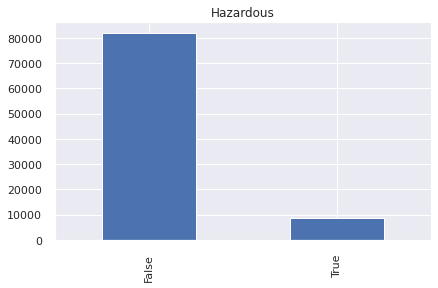

In [ ]:
# plot distribution of Hazardous
df.hazardous.value_counts().plot(kind='bar')
plt.title('Hazardous')
plt.show()

In [ ]:
print("Proportion of Hazardous N.E.O.'s")
print(df["hazardous"].value_counts() / len(df))

Proportion of Hazardous N.E.O.'s
False    0.902682
True     0.097318
Name: hazardous, dtype: float64


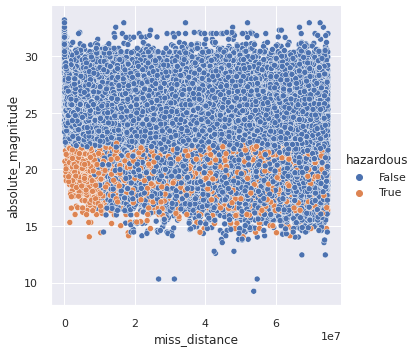

In [ ]:
sns.relplot(x='miss_distance', y = 'absolute_magnitude', hue = "hazardous", data = df)

In [ ]:
pip install AutoViz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Shape of your Data Set loaded: (90836, 8)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
relative_velocity,90828,float64,0,0.000000,99.991193,0,
miss_distance,90536,float64,0,0.000000,99.669734,0,
id,27423,int64,0,0.000000,30.189572,0,
name,27423,object,0,0.000000,30.189572,1,combine rare categories
est_diameter_min,1638,float64,0,0.000000,1.803250,0,highly skewed column: remove outliers or do box-cox transform
est_diameter_max,1638,float64,0,0.000000,1.803250,0,highly skewed column: remove outliers or do box-cox transform
absolute_magnitude,1638,float64,0,0.000000,1.803250,0,


    7 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Binary_Classification problem #####################


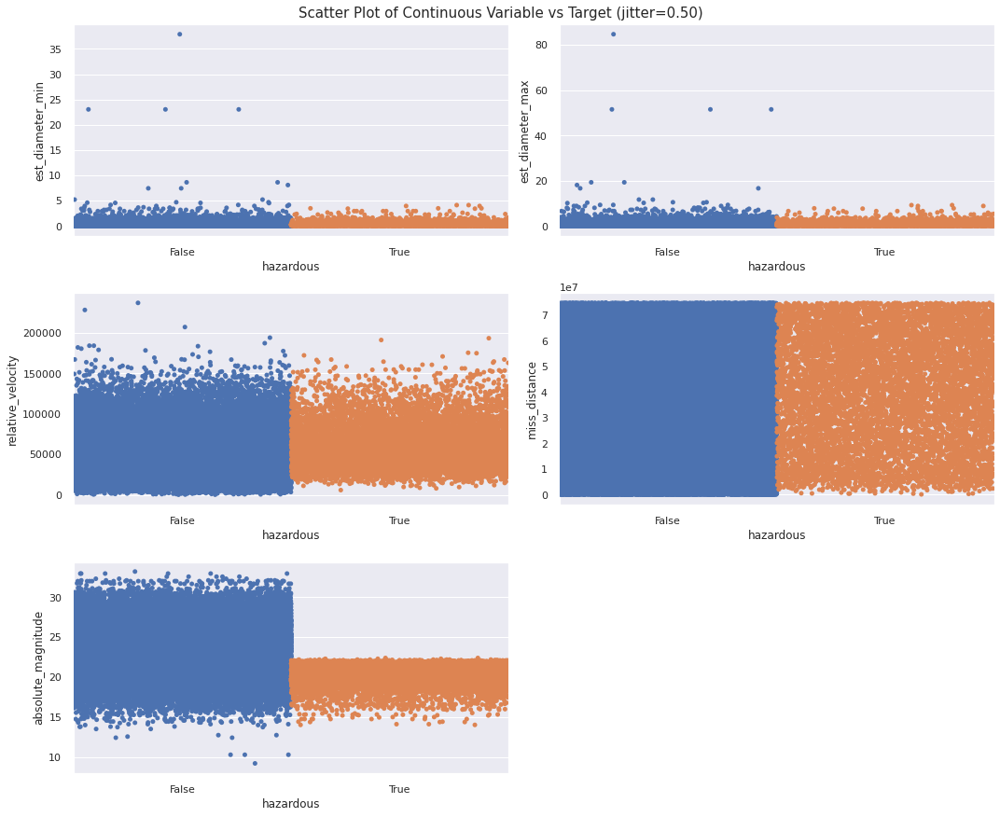

Total Number of Scatter Plots = 15


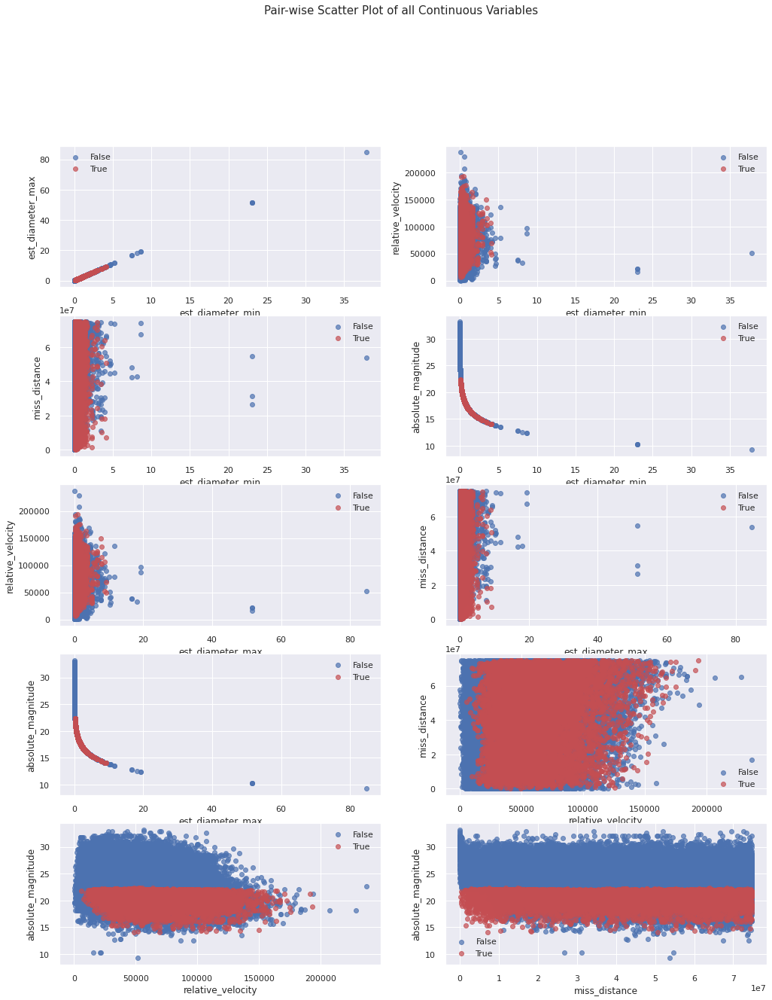

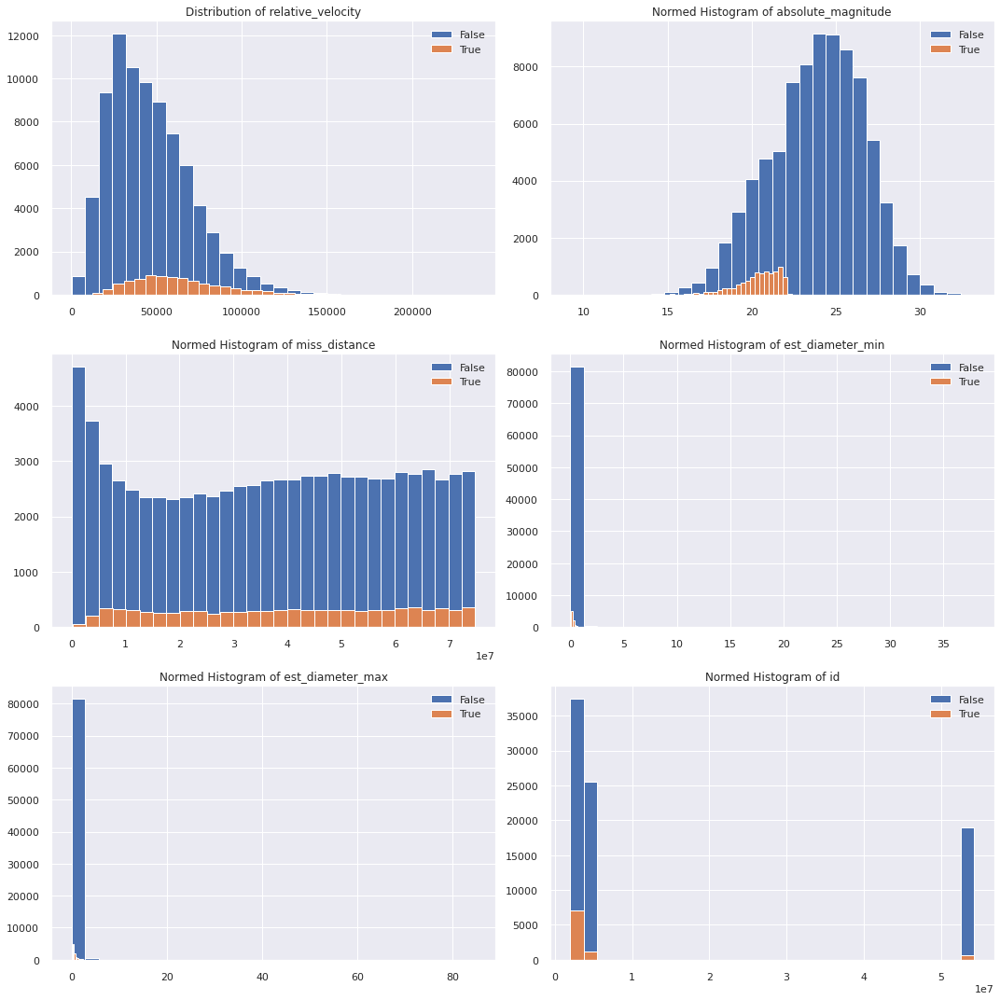

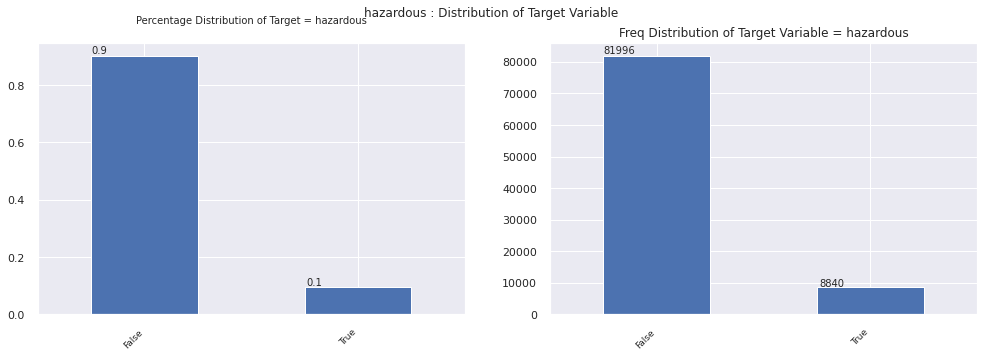

Could not draw some Violin Plots


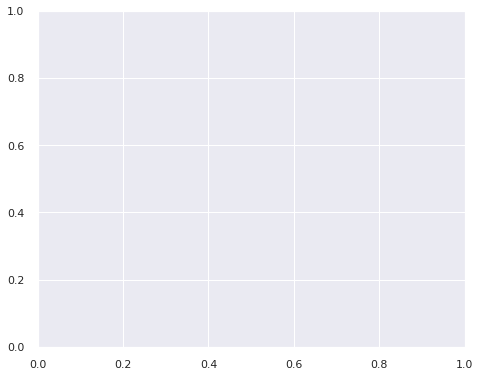

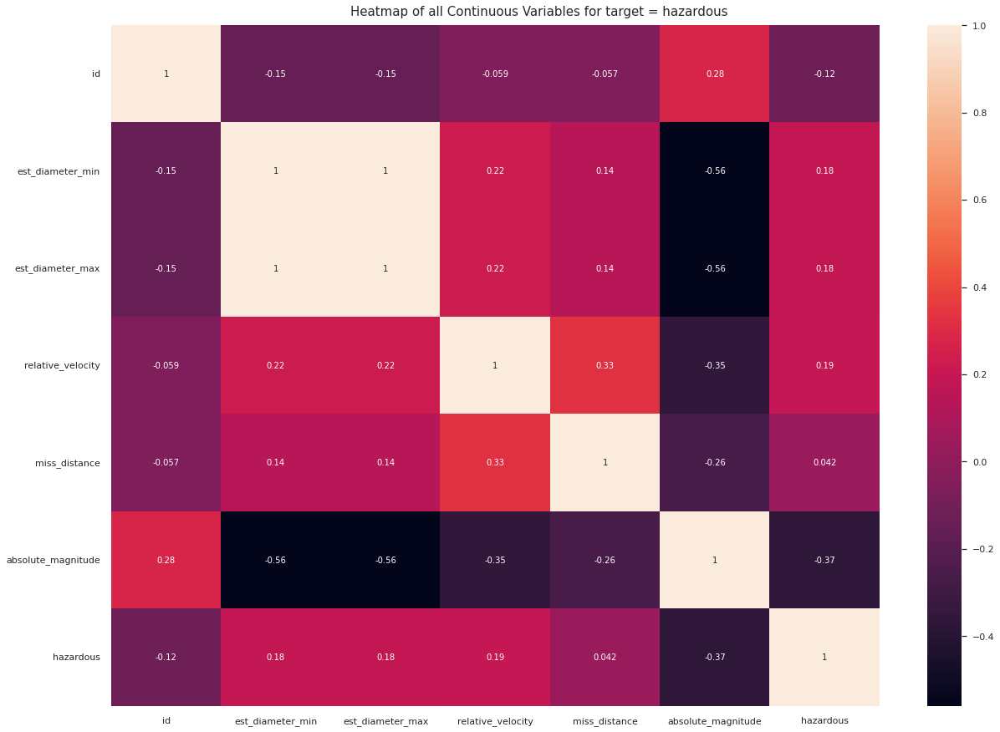

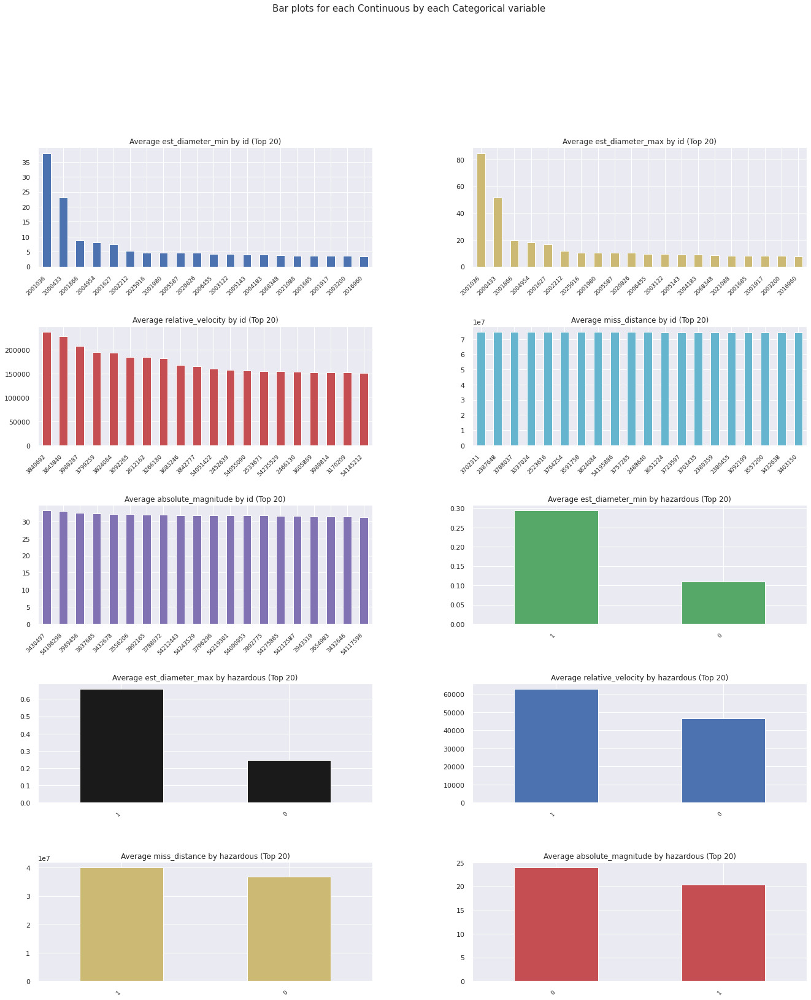

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Do

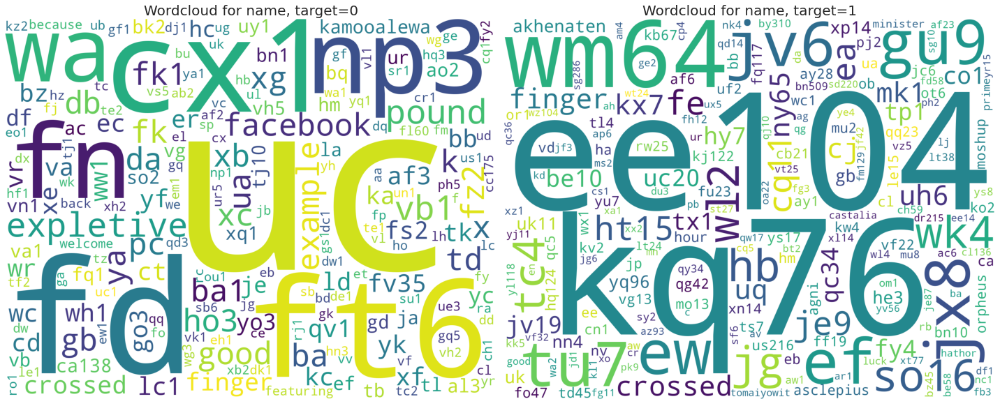

All Plots done
Time to run AutoViz = 86 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [ ]:
#auto eda on target variable
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()
%matplotlib inline
target = 'hazardous'
dft = AV.AutoViz('',
                 ',',
                 target,
                 df,
                 max_rows_analyzed=99999,
                 max_cols_analyzed=30
                 )

In [ ]:
#polar plot of mission distance and velocity
fig = px.scatter_polar(df, r="relative_velocity", theta="miss_distance")
fig.show()

In [ ]:
#Numeric Data 
numeric_df = ["est_diameter_min","est_diameter_max","relative_velocity","miss_distance","absolute_magnitude"]
df[numeric_df].describe()

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude
count,90836.000000,90836.000000,90836.000000,9.083600e+04,90836.000000
mean,0.127432,0.284947,48066.918918,3.706655e+07,23.527103
std,0.298511,0.667491,25293.296961,2.235204e+07,2.894086
min,0.000609,0.001362,203.346433,6.745533e+03,9.230000
25%,0.019256,0.043057,28619.020645,1.721082e+07,21.340000
50%,0.048368,0.108153,44190.117890,3.784658e+07,23.700000
75%,0.143402,0.320656,62923.604633,5.654900e+07,25.700000
max,37.892650,84.730541,236990.128088,7.479865e+07,33.200000


In [ ]:
# pearman correlation 
# spearman's correlation doesn't assume linear relationship
print("Spearman Correlations with est_diameter_min\n")
print(df.corr(method="spearman")["est_diameter_min"])

Spearman Correlations with est_diameter_min

id                   -0.500122
est_diameter_min      1.000000
est_diameter_max      1.000000
relative_velocity     0.335507
miss_distance         0.269061
absolute_magnitude   -1.000000
Name: est_diameter_min, dtype: float64


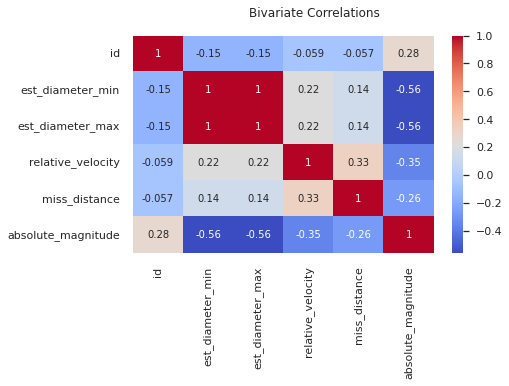

In [ ]:
sns.heatmap(df.corr(), annot=True, cmap='coolwarm')
plt.suptitle('Bivariate Correlations')
plt.show()


In [ ]:
# Drop one diameter variable since they are perfectly correlated
df.drop(["est_diameter_min"], axis = 1, inplace = True)

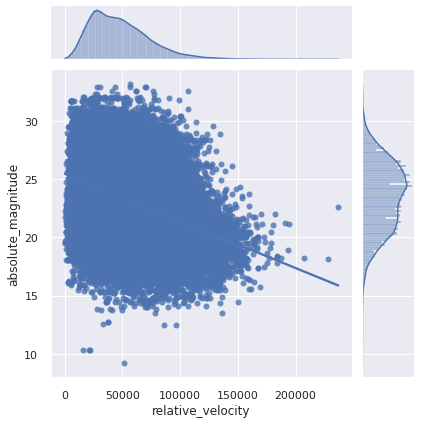

In [ ]:
#distribution of speed and size
sns.jointplot("relative_velocity", "absolute_magnitude", data = df, kind='reg')

In [ ]:
#Parallel Coordinates plot
fig = px.parallel_coordinates(df, color="hazardous",
                              dimensions=['est_diameter_max', 'absolute_magnitude', 'relative_velocity',
                                          'miss_distance'],
                              color_continuous_scale=px.colors.diverging.Tealrose,
                              color_continuous_midpoint=2)
fig.show()

In [ ]:
#3d plot of relationship 
fig = px.scatter_3d(df, x='est_diameter_max', y='relative_velocity', z='absolute_magnitude',
              color='miss_distance')
fig.show()

In [ ]:
#3d plot of relationship
fig = px.line_3d(df, x='absolute_magnitude', y='relative_velocity', z='miss_distance',
                    color='hazardous', symbol='hazardous')
fig.show()

In [ ]:
df

,id,name,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude,hazardous
0,2162635,162635 (2000 SS164),2.679415,13569.249224,5.483974e+07,16.73,False
1,2277475,277475 (2005 WK4),0.594347,73588.726663,6.143813e+07,20.00,True
2,2512244,512244 (2015 YE18),1.614507,114258.692129,4.979872e+07,17.83,False
3,3596030,(2012 BV13),0.215794,24764.303138,2.543497e+07,22.20,False
4,3667127,(2014 GE35),0.570217,42737.733765,4.627557e+07,20.09,True
...,...,...,...,...,...,...,...
90831,3763337,(2016 VX1),0.059435,52078.886692,1.230039e+07,25.00,False
90832,3837603,(2019 AD3),0.037501,46114.605073,5.432121e+07,26.00,False
90833,54017201,(2020 JP3),0.071456,7566.807732,2.840077e+07,24.60,False
90834,54115824,(2021 CN5),0.016370,69199.154484,6.869206e+07,27.80,False


In [ ]:
#3d line  plot relationship 
fig = px.line_3d(df, x="absolute_magnitude", y="relative_velocity", z="est_diameter_max", color="hazardous")
fig.show()

***Modeling***

In [ ]:
# remove those two columns
#df = df.drop(['orbiting_body','sentry_object'], axis=1)
#df.head()

In [ ]:
# Split into x and y ,Irrelevant features dropped
x = df.drop(["id","name",'est_diameter_max',"est_diameter_max",'hazardous',"miss_distance","absolute_magnitude"] , axis = 1)

In [ ]:
# Hazardous Transformed into int
y = df.hazardous.astype("int")
print(x.shape, y.shape)

(90836, 1) (90836,)


In [ ]:
# Train & Test Splitting
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)

In [ ]:
# XG Boost Model
XGBC = XGBClassifier()
XGBC.fit(X_train, y_train)
XGBC_pred = XGBC.predict(X_test)
Acc_XGBC = round(accuracy_score(XGBC_pred, y_test) * 100,2)
print(Acc_XGBC)

90.12


In [ ]:
# KNN Model
KNN = KNeighborsClassifier(n_neighbors = 3)
KNN.fit(X_train, y_train)
KNN_pred = KNN.predict(X_test)
Acc_KNN = round(accuracy_score(KNN_pred, y_test) * 100, 2)
print(Acc_KNN)

87.48


In [ ]:
# RandomForst Model
RF = RandomForestClassifier()
RF.fit(X_train, y_train)
RF_pred = RF.predict(X_test)
Acc_RF = round(accuracy_score(RF_pred, y_test) * 100, 2)
print(Acc_RF)

83.48


In [ ]:
# Gaussian Naive Bayes Model
GNB = GaussianNB()
GNB.fit(X_train, y_train)
GNB_pred = GNB.predict(X_test)
Acc_GNB = round(accuracy_score(GNB_pred,y_test) * 100, 2)
print(Acc_GNB)

89.63


In [ ]:
# DecisionTree Model
DTC = DecisionTreeClassifier()
DTC.fit(X_train, y_train)
DTC_pred = DTC.predict(X_test)
Acc_DTC = round(accuracy_score(DTC_pred, y_test) * 100, 2)
print(Acc_DTC)

83.47


In [ ]:
# Print all models
models = pd.DataFrame({
    'Model': ['Random Forest', 'XG Boost', 'Gaussian Naive Bayes', 
              'KNeighborsClassifier', 'DecisionTreeClassifier'],
    'Score': [Acc_RF, Acc_XGBC, Acc_GNB, 
              Acc_KNN, Acc_DTC]})
models.sort_values(by='Score', ascending=False)

,Model,Score
1,XG Boost,90.12
2,Gaussian Naive Bayes,89.63
3,KNeighborsClassifier,87.48
0,Random Forest,83.48
4,DecisionTreeClassifier,83.47
